<a href="https://colab.research.google.com/github/MukeshMishraReloaded/projects/blob/main/Scaler_Clustering.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# SCALER BUSINESS CASE

#Problem Statement

Scaler is an online tech-versity offering intensive computer science & Data Science courses through live classes delivered by tech leaders and subject matter experts. The meticulously structured program enhances the skills of software professionals by offering a modern curriculum with exposure to the latest technologies. It is a product by InterviewBit.

You are working as a data scientist with the analytics vertical of Scaler, focused on profiling the best companies and job positions to work for from the Scaler database. You are provided with the information for a segment of learners and tasked to cluster them on the basis of their job profile, company, and other features. Ideally, these clusters should have similar characteristics.

#Dataset:

Dataset Link: scaler_kmeans.csv

Data Dictionary:

‘Unnamed 0’ - Index of the dataset

Email_hash - Anonymised Personal Identifiable Information (PII)

Company_hash - This represents an anonymized identifier for the company, which is the current employer of the learner.

orgyear - Employment start date

CTC - Current CTC

Job_position - Job profile in the company

CTC_updated_year - Year in which CTC got updated (Yearly increments, Promotions)

In [64]:
#EDA

In [65]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import re
import warnings
warnings.filterwarnings('ignore')

In [66]:
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

In [67]:
df_scaler = pd.read_csv("https://d2beiqkhq929f0.cloudfront.net/public_assets/assets/000/002/856/original/scaler_clustering.csv")

In [68]:
df_scaler.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 205843 entries, 0 to 205842
Data columns (total 7 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Unnamed: 0        205843 non-null  int64  
 1   company_hash      205799 non-null  object 
 2   email_hash        205843 non-null  object 
 3   orgyear           205757 non-null  float64
 4   ctc               205843 non-null  int64  
 5   job_position      153279 non-null  object 
 6   ctc_updated_year  205843 non-null  float64
dtypes: float64(2), int64(2), object(3)
memory usage: 11.0+ MB


In [69]:
df_scaler.drop(columns=['Unnamed: 0'], inplace=True)
df_scaler.drop(columns=['email_hash'],inplace=True)
#dropping email will create different records and there will be no confusion for clustering

In [70]:
df_scaler.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 205843 entries, 0 to 205842
Data columns (total 5 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   company_hash      205799 non-null  object 
 1   orgyear           205757 non-null  float64
 2   ctc               205843 non-null  int64  
 3   job_position      153279 non-null  object 
 4   ctc_updated_year  205843 non-null  float64
dtypes: float64(2), int64(1), object(2)
memory usage: 7.9+ MB


In [71]:
df_scaler.describe()

,orgyear,ctc,ctc_updated_year
count,205757.000000,2.058430e+05,205843.000000
mean,2014.882750,2.271685e+06,2019.628231
std,63.571115,1.180091e+07,1.325104
min,0.000000,2.000000e+00,2015.000000
25%,2013.000000,5.300000e+05,2019.000000
50%,2016.000000,9.500000e+05,2020.000000
75%,2018.000000,1.700000e+06,2021.000000
max,20165.000000,1.000150e+09,2021.000000


In [72]:
df_scaler.describe(include=['O'])

,company_hash,job_position
count,205799,153279
unique,37299,1016
top,nvnv wgzohrnvzwj otqcxwto,Backend Engineer
freq,8337,43554


In [73]:
df_scaler.isna().sum()

company_hash           44
orgyear                86
ctc                     0
job_position        52564
ctc_updated_year        0
dtype: int64

In [74]:
df_scaler['company_hash'].value_counts()

company_hash
nvnv wgzohrnvzwj otqcxwto         8337
xzegojo                           5381
vbvkgz                            3481
zgn vuurxwvmrt vwwghzn            3411
wgszxkvzn                         3240
                                  ... 
onvqmhwpo                            1
bvsxw ogenfvqt uqxcvnt rxbxnta       1
agsbv ojontbo                        1
vnnhzt xzegwgb                       1
bvptbjnqxu td vbvkgz                 1
Name: count, Length: 37299, dtype: int64

In [75]:
duplicates=df_scaler.duplicated()
print(df_scaler.shape)

(205843, 5)


In [76]:
# Remove duplicate rows based on all columns
df_scaler.drop_duplicates(inplace=True)
print("\nDataFrame after removing duplicates based on all columns:")
print(df_scaler.shape)



DataFrame after removing duplicates based on all columns:
(188372, 5)


In [77]:
# Calculate the total number of missing values in each column
missing_values = df_scaler.isnull().sum()
print("\nTotal Missing Values:")
print(missing_values)

# Calculate the percentage of missing values in each column
total_rows = df_scaler.shape[0]
missing_percentage = (missing_values / total_rows) * 100
print("\nPercentage of Missing Values:")
print(missing_percentage)


Total Missing Values:
company_hash           44
orgyear                86
ctc                     0
job_position        43514
ctc_updated_year        0
dtype: int64

Percentage of Missing Values:
company_hash         0.023358
orgyear              0.045654
ctc                  0.000000
job_position        23.100036
ctc_updated_year     0.000000
dtype: float64


In [78]:
# Handling missing values
df_scaler['company_hash'].fillna('Other', inplace=True)
df_scaler['job_position'].fillna('Other', inplace=True)

In [79]:
from sklearn.impute import KNNImputer
from sklearn.preprocessing import LabelEncoder

# Step 1: Temporarily encode categorical variables for KNN imputation
label_encoders = {}
for col in df_scaler.select_dtypes(include=['object']).columns:
    le = LabelEncoder()
    df_scaler[col] = le.fit_transform(df_scaler[col].astype(str))
    label_encoders[col] = le

# Perform KNN Imputation
imputer = KNNImputer(n_neighbors=5)
df_scaler[:] = imputer.fit_transform(df_scaler)

# Step 2: Restore categorical variables
for col, le in label_encoders.items():
    df_scaler[col] = le.inverse_transform(df_scaler[col].astype(int))

# Display the DataFrame after KNN Imputation
print("\nDataFrame after KNN Imputation:")
print(df_scaler)


DataFrame after KNN Imputation:
                     company_hash  orgyear      ctc        job_position  ctc_updated_year
0                  atrgxnnt xzaxv   2016.0  1100000               Other            2020.0
1       qtrxvzwt xzegwgbb rxbxnta   2018.0   449999  FullStack Engineer            2019.0
2                   ojzwnvwnxw vx   2015.0  2000000    Backend Engineer            2020.0
3                       ngpgutaxv   2017.0   700000    Backend Engineer            2019.0
4                      qxen sqghu   2017.0  1400000  FullStack Engineer            2019.0
...                           ...      ...      ...                 ...               ...
205838                  vuurt xzw   2008.0   220000               Other            2019.0
205839                  husqvawgb   2017.0   500000               Other            2020.0
205840                   vwwgrxnt   2021.0   700000               Other            2021.0
205841             zgn vuurxwvmrt   2019.0  5100000               O

In [80]:
# Calculate the total number of missing values in each column
missing_values = df_scaler.isnull().sum()
print("\nTotal Missing Values:")
print(missing_values)

# Calculate the percentage of missing values in each column
total_rows = df_scaler.shape[0]
missing_percentage = (missing_values / total_rows) * 100
print("\nPercentage of Missing Values:")
print(missing_percentage)


Total Missing Values:
company_hash        0
orgyear             0
ctc                 0
job_position        0
ctc_updated_year    0
dtype: int64

Percentage of Missing Values:
company_hash        0.0
orgyear             0.0
ctc                 0.0
job_position        0.0
ctc_updated_year    0.0
dtype: float64


In [81]:
df_scaler['ctc_updated_year']=df_scaler['ctc_updated_year'].astype('int64')
df_scaler['orgyear']=df_scaler['orgyear'].astype('int64')
df_scaler.head(5)

,company_hash,orgyear,ctc,job_position,ctc_updated_year
0,atrgxnnt xzaxv,2016,1100000,Other,2020
1,qtrxvzwt xzegwgbb rxbxnta,2018,449999,FullStack Engineer,2019
2,ojzwnvwnxw vx,2015,2000000,Backend Engineer,2020
3,ngpgutaxv,2017,700000,Backend Engineer,2019
4,qxen sqghu,2017,1400000,FullStack Engineer,2019


In [82]:
df=df_scaler.copy()

In [83]:
import re
from datetime import datetime

# Current year for calculating years of experience
current_year = datetime.now().year

In [84]:
# Define a function to normalize job titles
def normalize_column(value):
    # Convert to lowercase and remove whitespace
    value = value.strip()
    value=re.sub('[^A-Za-z0-9 ]+', '', value)
    return value

In [85]:
# Removing special characters from job_position
df_scaler['job_position'] = df_scaler['job_position'].apply(normalize_column)

# Creating 'Years of Experience' column
df_scaler['years_of_experience'] = current_year - df_scaler['orgyear']


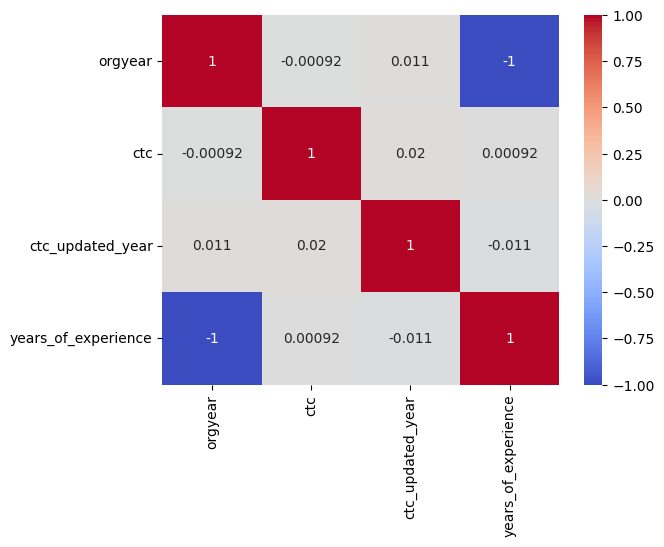

In [86]:
import seaborn as sns
import matplotlib.pyplot as plt

# Correlation Matrix Heatmap
continuous_columns = df_scaler.select_dtypes(include=['float64', 'int64']).columns
corr = df_scaler[continuous_columns].corr()
sns.heatmap(corr, annot=True, cmap='coolwarm')
plt.show()


In [87]:
df_scaler.head(10)

,company_hash,orgyear,ctc,job_position,ctc_updated_year,years_of_experience
0,atrgxnnt xzaxv,2016,1100000,Other,2020,8
1,qtrxvzwt xzegwgbb rxbxnta,2018,449999,FullStack Engineer,2019,6
2,ojzwnvwnxw vx,2015,2000000,Backend Engineer,2020,9
3,ngpgutaxv,2017,700000,Backend Engineer,2019,7
4,qxen sqghu,2017,1400000,FullStack Engineer,2019,7
5,yvuuxrj hzbvqqxta bvqptnxzs ucn rna,2018,700000,FullStack Engineer,2020,6
6,lubgqsvz wyvot wg,2018,1500000,FullStack Engineer,2019,6
7,vwwtznhqt ntwyzgrgsj,2019,400000,Backend Engineer,2019,5
8,utqoxontzn ojontbo,2020,450000,Other,2019,4
9,xrbhd,2019,360000,Other,2019,5


In [88]:
df_scaler['ctc'] = df['ctc'].clip(upper=df['ctc'].quantile(0.975), lower=df['ctc'].quantile(0.025))

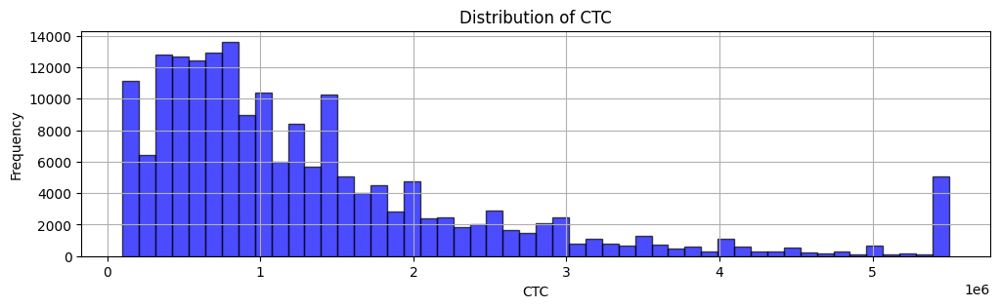

In [89]:
import matplotlib.pyplot as plt

# Plotting histogram for CTC
plt.figure(figsize=(12, 3))
plt.hist(df_scaler['ctc'], bins=50, color='blue', edgecolor='black', alpha=0.7)
plt.title('Distribution of CTC')
plt.xlabel('CTC')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()


In [90]:
df_scaler['orgyear'] = df['orgyear'].clip(upper=df['orgyear'].quantile(0.975), lower=df['orgyear'].quantile(0.025))

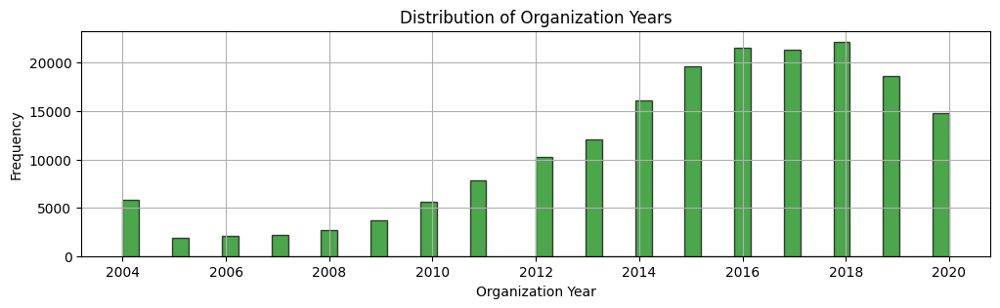

In [91]:
import matplotlib.pyplot as plt

# Plotting histogram for orgyear
plt.figure(figsize=(12, 3))
plt.hist(df_scaler['orgyear'], bins=50, color='green', edgecolor='black', alpha=0.7)
plt.title('Distribution of Organization Years')
plt.xlabel('Organization Year')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

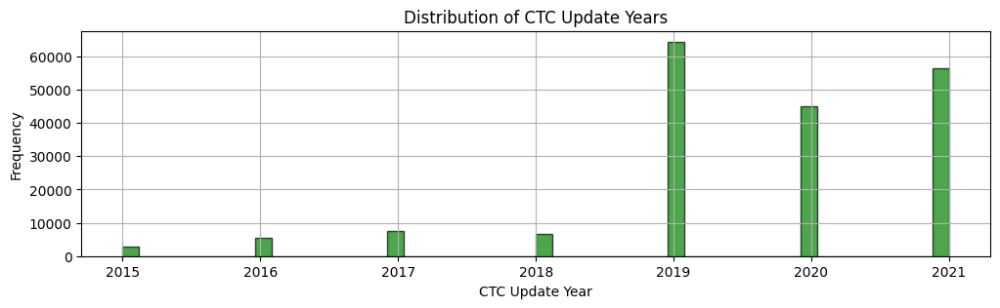

In [92]:
import matplotlib.pyplot as plt

# Plotting histogram for orgyear
plt.figure(figsize=(12, 3))
plt.hist(df_scaler['ctc_updated_year'], bins=50, color='green', edgecolor='black', alpha=0.7)
plt.title('Distribution of CTC Update Years')
plt.xlabel('CTC Update Year')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

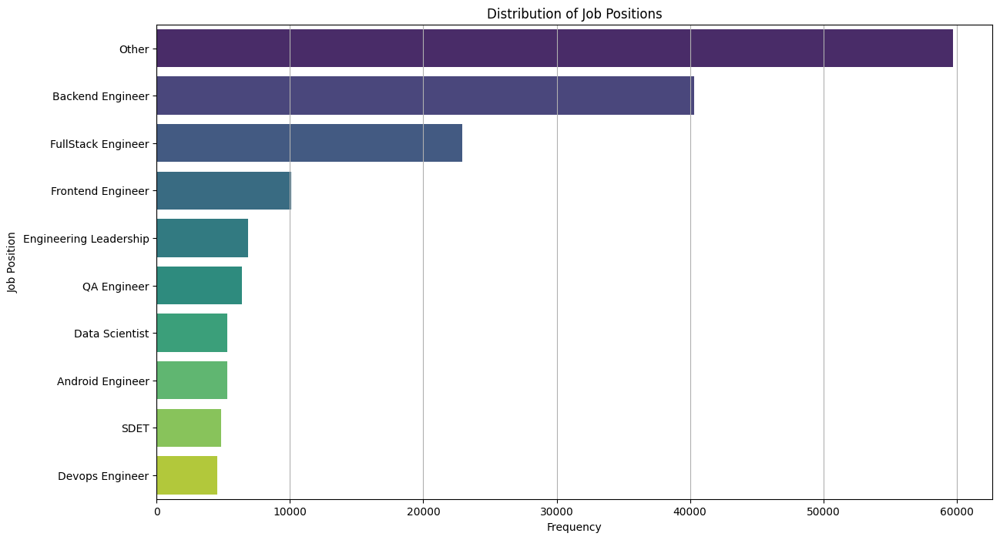

In [93]:
import matplotlib.pyplot as plt
import seaborn as sns

# Count the frequency of each job position
job_position_counts = df_scaler['job_position'].value_counts().nlargest(10)

# Plotting bar plot for job positions
plt.figure(figsize=(14, 8))
sns.barplot(y=job_position_counts.index, x=job_position_counts.values, palette='viridis')
plt.title('Distribution of Job Positions')
plt.xlabel('Frequency')
plt.ylabel('Job Position')
plt.grid(True, axis='x')
plt.show()


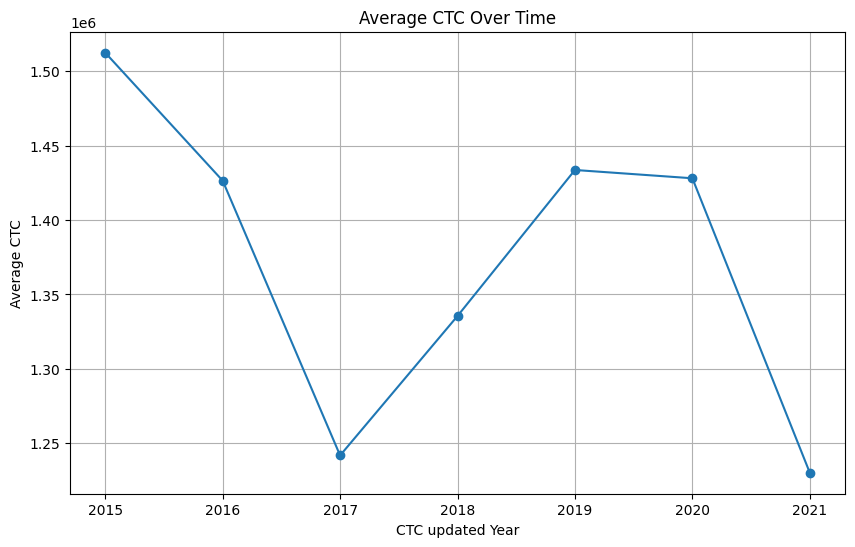

In [94]:
# Calculate the average CTC over time
# Here, we assume 'ctc_updated_year' is the year when the CTC was updated
average_ctc_over_time = df_scaler.groupby('ctc_updated_year')['ctc'].mean().reset_index()

# Plot the average CTC over time
plt.figure(figsize=(10, 6))
plt.plot(average_ctc_over_time['ctc_updated_year'], average_ctc_over_time['ctc'], marker='o')
plt.title('Average CTC Over Time')
plt.xlabel('CTC updated Year')
plt.ylabel('Average CTC')
plt.grid(True)
plt.show()


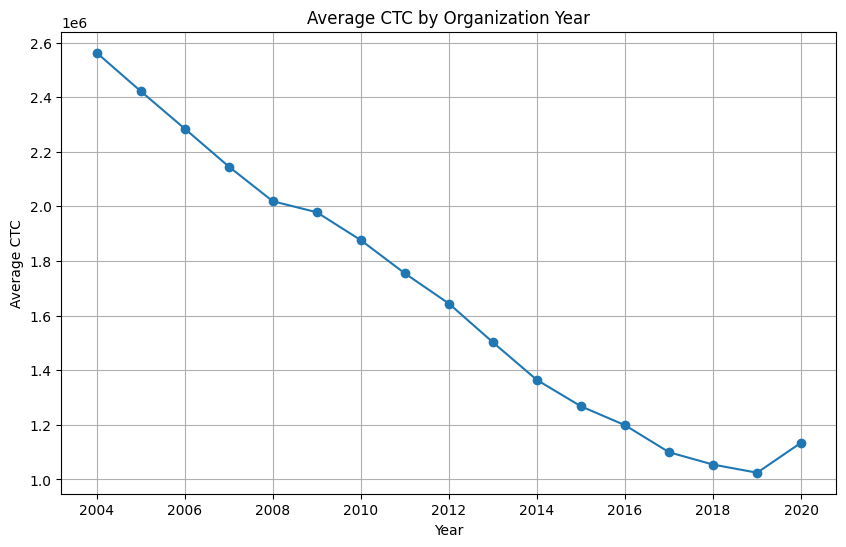

In [95]:
# Calculate the average CTC over time
# Here, we assume 'ctc_updated_year' is the year when the CTC was updated
average_ctc_over_time = df_scaler.groupby('orgyear')['ctc'].mean().reset_index()

# Plot the average CTC over time
plt.figure(figsize=(10, 6))
plt.plot(average_ctc_over_time['orgyear'], average_ctc_over_time['ctc'], marker='o')
plt.title('Average CTC by Organization Year')
plt.xlabel('Year')
plt.ylabel('Average CTC')
plt.grid(True)
plt.show()


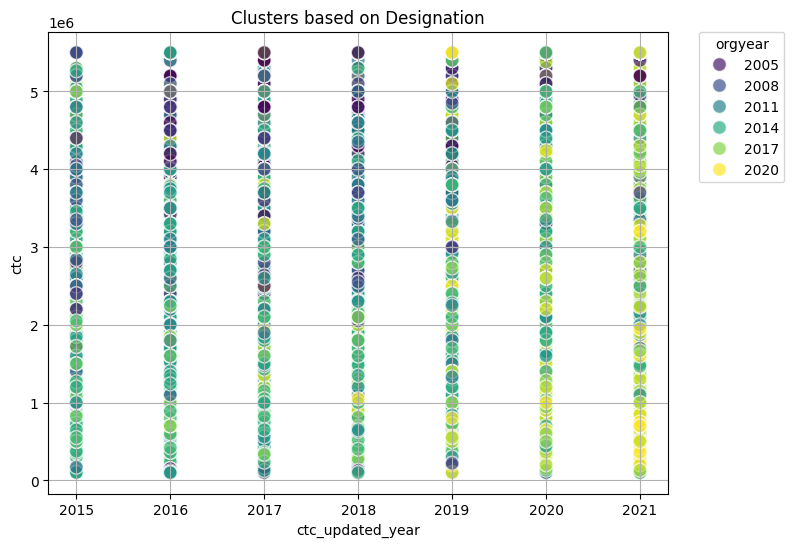

In [96]:
import matplotlib.pyplot as plt
import seaborn as sns

# Function to plot clusters with centers
def plot_clusters_with_centers(df, x_col, y_col, hue_col, title):
    plt.figure(figsize=(8, 6))
    sns.scatterplot(data=df, x=x_col, y=y_col, hue=hue_col, palette="viridis", s=100, alpha=0.7, edgecolor="w", linewidth=1)

    plt.title(title)
    plt.xlabel(x_col)
    plt.ylabel(y_col)
    plt.legend(title=hue_col, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    plt.grid(True)
    plt.show()

# Plotting clusters based on designation with centers
plot_clusters_with_centers(df_scaler, 'ctc_updated_year', 'ctc', 'orgyear', 'Clusters based on Designation')


In [97]:
import plotly.express as px
fig = px.scatter_3d(df_scaler, x='company_hash', y='ctc', z='job_position', width=600, height=600)
fig.update_traces(marker=dict(size=2), selector=dict(mode='markers'))
fig.show()

In [98]:
# Group by Company, Job Position, and Years of Experience
grouped = df_scaler.groupby(['company_hash', 'job_position', 'years_of_experience'])

# Calculate the 5-point summary for CTC
summary = grouped['ctc'].agg(['mean', 'median', 'max', 'min', 'count']).reset_index()

# Rename the columns for clarity
summary.columns = ['company_hash', 'job_position', 'years_of_experience', 'ctc_mean', 'ctc_median', 'ctc_max', 'ctc_min', 'ctc_count']

print(summary.head())


                     company_hash       job_position  years_of_experience   ctc_mean  ctc_median  ctc_max  ctc_min  ctc_count
0                               0              Other                    4   100000.0    100000.0   100000   100000          2
1                            0000              Other                    7   300000.0    300000.0   300000   300000          1
2                      01 ojztqsj   Android Engineer                    8   270000.0    270000.0   270000   270000          1
3                      01 ojztqsj  Frontend Engineer                   13   830000.0    830000.0   830000   830000          1
4  05mz exzytvrny uqxcvnt rxbxnta   Backend Engineer                    5  1100000.0   1100000.0  1100000  1100000          1


In [99]:
# Merging the summary back into the original dataframe
df_scaler = pd.merge(df_scaler, summary, on=['company_hash', 'job_position', 'years_of_experience'], how='left')

# Creating flags based on CTC greater than the average
df_scaler['designation'] = df_scaler.apply(lambda x: 1 if x['ctc'] > x['ctc_mean'] else (2 if x['ctc'] == x['ctc_mean'] else 3), axis=1)

df_scaler.head(5)

,company_hash,orgyear,ctc,job_position,ctc_updated_year,years_of_experience,ctc_mean,ctc_median,ctc_max,ctc_min,ctc_count,designation
0,atrgxnnt xzaxv,2016,1100000,Other,2020,8,1.100000e+06,1100000.0,1100000,1100000,1,2
1,qtrxvzwt xzegwgbb rxbxnta,2018,449999,FullStack Engineer,2019,6,7.742856e+05,750000.0,1200000,449999,7,3
2,ojzwnvwnxw vx,2015,2000000,Backend Engineer,2020,9,2.000000e+06,2000000.0,2000000,2000000,1,2
3,ngpgutaxv,2017,700000,Backend Engineer,2019,7,1.158571e+06,1200000.0,1750000,700000,7,3
4,qxen sqghu,2017,1400000,FullStack Engineer,2019,7,1.400000e+06,1400000.0,1400000,1400000,1,2


In [100]:
# Repeat the same analysis at Company & Job Position level
company_job_clusters = df_scaler.groupby(['company_hash', 'job_position'])
company_job_summary = company_job_clusters['ctc'].agg(['mean', 'median', 'max', 'min', 'count']).reset_index()
company_job_summary.rename(columns={'mean': 'ctc_mean', 'median': 'ctc_median', 'max': 'ctc_max', 'min': 'ctc_min', 'count': 'ctc_count'}, inplace=True)

df_scaler = pd.merge(df_scaler, company_job_summary, on=['company_hash', 'job_position'], suffixes=('', '_job'), how='left')
df_scaler['class'] = df_scaler.apply(lambda x: 1 if x['ctc'] > x['ctc_mean_job'] else (2 if x['ctc'] == x['ctc_mean_job'] else 3), axis=1)

df_scaler.head(5)

,company_hash,orgyear,ctc,job_position,ctc_updated_year,years_of_experience,ctc_mean,ctc_median,ctc_max,ctc_min,ctc_count,designation,ctc_mean_job,ctc_median_job,ctc_max_job,ctc_min_job,ctc_count_job,class
0,atrgxnnt xzaxv,2016,1100000,Other,2020,8,1.100000e+06,1100000.0,1100000,1100000,1,2,1.085000e+06,1085000.0,1100000,1070000,2,1
1,qtrxvzwt xzegwgbb rxbxnta,2018,449999,FullStack Engineer,2019,6,7.742856e+05,750000.0,1200000,449999,7,3,9.511363e+05,800000.0,2000000,300000,22,3
2,ojzwnvwnxw vx,2015,2000000,Backend Engineer,2020,9,2.000000e+06,2000000.0,2000000,2000000,1,2,2.000000e+06,2000000.0,2000000,2000000,1,2
3,ngpgutaxv,2017,700000,Backend Engineer,2019,7,1.158571e+06,1200000.0,1750000,700000,7,3,1.500000e+06,1540000.0,3500000,520000,25,3
4,qxen sqghu,2017,1400000,FullStack Engineer,2019,7,1.400000e+06,1400000.0,1400000,1400000,1,2,8.466667e+05,600000.0,1400000,540000,3,1


In [101]:
# Repeat the same analysis at Company level
company_clusters = df_scaler.groupby(['company_hash'])
company_summary = company_clusters['ctc'].agg(['mean', 'median', 'max', 'min', 'count']).reset_index()
company_summary.rename(columns={'mean': 'ctc_mean', 'median': 'ctc_median', 'max': 'ctc_max', 'min': 'ctc_min', 'count': 'ctc_count'}, inplace=True)

df_scaler = pd.merge(df_scaler, company_summary, on='company_hash', suffixes=('', '_company'), how='left')
df_scaler['tier'] = df_scaler.apply(lambda x: 1 if x['ctc'] > x['ctc_mean_company'] else (2 if x['ctc'] == x['ctc_mean_company'] else 3), axis=1)

df_scaler.head(5)

,company_hash,orgyear,ctc,job_position,ctc_updated_year,years_of_experience,ctc_mean,ctc_median,ctc_max,ctc_min,ctc_count,designation,ctc_mean_job,ctc_median_job,ctc_max_job,ctc_min_job,ctc_count_job,class,ctc_mean_company,ctc_median_company,ctc_max_company,ctc_min_company,ctc_count_company,tier
0,atrgxnnt xzaxv,2016,1100000,Other,2020,8,1.100000e+06,1100000.0,1100000,1100000,1,2,1.085000e+06,1085000.0,1100000,1070000,2,1,1.115667e+06,1070000.0,1771000,500000,9,3
1,qtrxvzwt xzegwgbb rxbxnta,2018,449999,FullStack Engineer,2019,6,7.742856e+05,750000.0,1200000,449999,7,3,9.511363e+05,800000.0,2000000,300000,22,3,1.248723e+06,900000.0,5500000,100000,411,3
2,ojzwnvwnxw vx,2015,2000000,Backend Engineer,2020,9,2.000000e+06,2000000.0,2000000,2000000,1,2,2.000000e+06,2000000.0,2000000,2000000,1,2,2.000000e+06,2000000.0,2000000,2000000,1,2
3,ngpgutaxv,2017,700000,Backend Engineer,2019,7,1.158571e+06,1200000.0,1750000,700000,7,3,1.500000e+06,1540000.0,3500000,520000,25,3,1.729478e+06,1400000.0,4700000,200000,67,3
4,qxen sqghu,2017,1400000,FullStack Engineer,2019,7,1.400000e+06,1400000.0,1400000,1400000,1,2,8.466667e+05,600000.0,1400000,540000,3,1,9.400000e+05,850000.0,1400000,540000,6,1


In [102]:
# Top 10 employees (earning more than most of the employees in the company) - Tier 1
top_tier_1 = df_scaler[df_scaler['tier'] == 1].nlargest(10, 'ctc')
# Display the dataframes for the specific questions
top_tier_1

,company_hash,orgyear,ctc,job_position,ctc_updated_year,years_of_experience,ctc_mean,ctc_median,ctc_max,ctc_min,ctc_count,designation,ctc_mean_job,ctc_median_job,ctc_max_job,ctc_min_job,ctc_count_job,class,ctc_mean_company,ctc_median_company,ctc_max_company,ctc_min_company,ctc_count_company,tier
25,nxbto xzntqztn,2015,5500000,Backend Engineer,2019,9,1.645250e+06,1491000.0,5500000,100000,16,1,1.826771e+06,1700000.0,5500000,100000,70,1,1.967767e+06,1700000.0,5500000,100000,317,1
38,evzzxt bvt,2006,5500000,QA Engineer,2019,18,2.820000e+06,2820000.0,5500000,140000,2,1,2.820000e+06,2820000.0,5500000,140000,2,1,3.685000e+06,4550000.0,5500000,140000,4,1
118,bgzgnjut,2011,5500000,Backend Engineer,2019,13,5.500000e+06,5500000.0,5500000,5500000,1,2,5.500000e+06,5500000.0,5500000,5500000,1,2,2.203158e+06,1800000.0,5500000,800000,19,1
189,tmvj,2015,5500000,FullStack Engineer,2020,9,2.825000e+06,2825000.0,5500000,150000,2,1,1.505000e+06,200000.0,5500000,120000,4,1,1.096459e+06,800000.0,5500000,100000,37,1
233,axoy ztnfgqp,2016,5500000,Backend Engineer,2020,8,5.500000e+06,5500000.0,5500000,5500000,1,2,3.587500e+06,3975000.0,5500000,900000,4,1,3.093750e+06,2225000.0,5500000,900000,8,1
300,ihvrwgbb,2019,5500000,Data Scientist,2019,5,5.500000e+06,5500000.0,5500000,5500000,1,2,2.295222e+06,2000000.0,5500000,125000,9,1,1.979048e+06,1800000.0,5500000,100000,574,1
304,axowgctq exzvzwxvr otqcxwto,2014,5500000,FullStack Engineer,2020,10,5.500000e+06,5500000.0,5500000,5500000,1,2,5.500000e+06,5500000.0,5500000,5500000,1,2,2.818750e+06,2818750.0,5500000,137500,2,1
400,lgyz attqt,2019,5500000,Other,2019,5,1.995000e+06,869999.5,5500000,740000,4,1,1.332400e+06,1050000.0,5500000,200000,25,1,1.503636e+06,1325000.0,5500000,200000,66,1
486,vagmt,2013,5500000,Backend Engineer,2021,11,2.837500e+06,2500000.0,5500000,400000,42,1,2.676769e+06,2475000.0,5500000,100000,412,1,2.555480e+06,2265000.0,5500000,100000,1286,1
508,ywr ntwyzgrgsxto,2014,5500000,Backend Engineer,2020,10,1.071118e+06,859999.5,5500000,200000,34,1,1.029034e+06,850000.0,5500000,100000,203,1,9.738674e+05,750000.0,5500000,100000,1211,1


In [103]:
# Top 10 employees of data science in each company earning more than their peers - Class 1
top_class_1 = df_scaler[(df_scaler['class'] == 1) & (df_scaler['job_position'].isin(['Data Analyst', 'Data Scientist']))].groupby('company_hash').apply(lambda x: x.nlargest(10, 'ctc')).reset_index(drop=True)
top_class_1

,company_hash,orgyear,ctc,job_position,ctc_updated_year,years_of_experience,ctc_mean,ctc_median,ctc_max,ctc_min,ctc_count,designation,ctc_mean_job,ctc_median_job,ctc_max_job,ctc_min_job,ctc_count_job,class,ctc_mean_company,ctc_median_company,ctc_max_company,ctc_min_company,ctc_count_company,tier
0,1bs,2018,1100000,Data Scientist,2021,6,1100000.0,1100000.0,1100000,1100000,1,2,9.500000e+05,950000.0,1100000,800000,2,1,1.458939e+06,1325000.0,3750000,600000,66,3
1,247vx,2010,2600000,Data Scientist,2015,14,2600000.0,2600000.0,2600000,2600000,1,2,2.172500e+06,2325000.0,2600000,1440000,4,1,1.504072e+06,1300000.0,5500000,100000,83,1
2,247vx,2008,2500000,Data Scientist,2019,16,2500000.0,2500000.0,2500000,2500000,1,2,2.172500e+06,2325000.0,2600000,1440000,4,1,1.504072e+06,1300000.0,5500000,100000,83,1
3,3p ntwyzgrgsxto,2018,1800000,Data Scientist,2019,6,1500000.0,1500000.0,1800000,1200000,2,1,1.300000e+06,1200000.0,1800000,1000000,4,1,1.170000e+06,1200000.0,1800000,650000,5,1
4,3rgi,2014,1710000,Data Scientist,2019,10,1710000.0,1710000.0,1710000,1710000,1,2,1.152500e+06,1150000.0,1710000,600000,4,1,1.230667e+06,1100000.0,2600000,100000,15,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1701,zxxn ntwyzgrgsxto,2007,5500000,Data Scientist,2019,17,5500000.0,5500000.0,5500000,5500000,1,2,3.066667e+06,2200000.0,5500000,1500000,3,1,1.065424e+06,750000.0,5500000,400000,59,1
1702,zxxn ntwyzgrgsxto rxbxnta,2015,1500000,Data Scientist,2020,9,1500000.0,1500000.0,1500000,1500000,1,2,1.166667e+06,1200000.0,1500000,800000,3,1,1.012697e+06,720000.0,5500000,100000,132,1
1703,zxxn ntwyzgrgsxto rxbxnta,2014,1200000,Data Scientist,2021,10,1200000.0,1200000.0,1200000,1200000,1,2,1.166667e+06,1200000.0,1500000,800000,3,1,1.012697e+06,720000.0,5500000,100000,132,1
1704,zxzlvwvqn,2017,800000,Data Analyst,2020,7,800000.0,800000.0,800000,800000,1,2,7.150000e+05,715000.0,800000,630000,2,1,1.739048e+06,1350000.0,5000000,180000,42,3


In [104]:
# Bottom 10 employees of data science in each company earning less than their peers - Class 3
bottom_class_3 = df_scaler[(df_scaler['class'] == 3) & (df_scaler['job_position'].isin(['Data Analyst', 'Data Scientist']))].groupby('company_hash').apply(lambda x: x.nsmallest(10, 'ctc')).reset_index(drop=True)
bottom_class_3

,company_hash,orgyear,ctc,job_position,ctc_updated_year,years_of_experience,ctc_mean,ctc_median,ctc_max,ctc_min,ctc_count,designation,ctc_mean_job,ctc_median_job,ctc_max_job,ctc_min_job,ctc_count_job,class,ctc_mean_company,ctc_median_company,ctc_max_company,ctc_min_company,ctc_count_company,tier
0,1bs,2004,800000,Data Scientist,2019,30,800000.0,800000.0,800000,800000,1,2,9.500000e+05,950000.0,1100000,800000,2,3,1.458939e+06,1325000.0,3750000,600000,66,3
1,247vx,2004,1440000,Data Scientist,2019,22,1440000.0,1440000.0,1440000,1440000,1,2,2.172500e+06,2325000.0,2600000,1440000,4,3,1.504072e+06,1300000.0,5500000,100000,83,3
2,247vx,2014,2150000,Data Scientist,2018,10,2150000.0,2150000.0,2150000,2150000,1,2,2.172500e+06,2325000.0,2600000,1440000,4,3,1.504072e+06,1300000.0,5500000,100000,83,1
3,3p ntwyzgrgsxto,2019,1000000,Data Scientist,2019,5,1000000.0,1000000.0,1000000,1000000,1,2,1.300000e+06,1200000.0,1800000,1000000,4,3,1.170000e+06,1200000.0,1800000,650000,5,3
4,3p ntwyzgrgsxto,2013,1200000,Data Scientist,2019,11,1200000.0,1200000.0,1200000,1200000,1,2,1.300000e+06,1200000.0,1800000,1000000,4,3,1.170000e+06,1200000.0,1800000,650000,5,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1985,zxxn ntwyzgrgsxto rxbxnta,2012,800000,Data Scientist,2021,12,800000.0,800000.0,800000,800000,1,2,1.166667e+06,1200000.0,1500000,800000,3,3,1.012697e+06,720000.0,5500000,100000,132,3
1986,zxzlvwvqn,2018,630000,Data Analyst,2019,6,630000.0,630000.0,630000,630000,1,2,7.150000e+05,715000.0,800000,630000,2,3,1.739048e+06,1350000.0,5000000,180000,42,3
1987,zxztrtvuo,2019,1250000,Data Scientist,2021,5,1250000.0,1250000.0,1250000,1250000,1,2,1.567500e+06,1385000.0,2250000,1250000,4,3,1.097889e+06,849999.5,5500000,400000,72,1
1988,zxztrtvuo,2018,1370000,Data Scientist,2019,6,1370000.0,1370000.0,1370000,1370000,1,2,1.567500e+06,1385000.0,2250000,1250000,4,3,1.097889e+06,849999.5,5500000,400000,72,1


In [105]:
# Bottom 10 employees (earning less than most of the employees in the company) - Tier 3
bottom_tier_3 = df_scaler[df_scaler['tier'] == 3].nsmallest(10, 'ctc')
bottom_tier_3

,company_hash,orgyear,ctc,job_position,ctc_updated_year,years_of_experience,ctc_mean,ctc_median,ctc_max,ctc_min,ctc_count,designation,ctc_mean_job,ctc_median_job,ctc_max_job,ctc_min_job,ctc_count_job,class,ctc_mean_company,ctc_median_company,ctc_max_company,ctc_min_company,ctc_count_company,tier
18,mvlvl exzotqc,2018,100000,Other,2021,6,1.000000e+05,100000.0,100000,100000,2,2,7.316667e+05,395000.0,1700000,100000,6,3,1.486154e+06,980000.0,5500000,100000,13,3
52,wqgoogctq egq fgqp,2004,100000,Other,2019,20,1.000000e+05,100000.0,100000,100000,1,2,2.517500e+06,2735000.0,4500000,100000,4,3,2.592000e+06,2350000.0,5500000,100000,20,3
102,vqsxrad,2009,100000,Backend Engineer,2019,15,1.000000e+05,100000.0,100000,100000,1,2,1.000000e+05,100000.0,100000,100000,1,2,4.800000e+05,400000.0,750000,100000,5,3
109,txzegwyxuo,2015,100000,QA Engineer,2019,9,1.000000e+05,100000.0,100000,100000,1,2,1.000000e+05,100000.0,100000,100000,1,2,4.656000e+05,360000.0,1300000,100000,15,3
176,stbvrng,2006,100000,FullStack Engineer,2019,18,1.000000e+05,100000.0,100000,100000,1,2,1.000000e+05,100000.0,100000,100000,2,2,1.021204e+06,1220000.0,2300000,100000,27,3
224,onvwpmgd,2018,100000,FullStack Engineer,2019,6,1.000000e+05,100000.0,100000,100000,1,2,1.000000e+05,100000.0,100000,100000,1,2,4.500000e+05,450000.0,800000,100000,2,3
228,ouqxzprq,2014,100000,SDET,2019,10,1.825000e+06,1900000.0,3400000,100000,4,3,1.389048e+06,1200000.0,3400000,100000,21,3,2.617450e+06,2500000.0,5500000,100000,149,3
255,mqgfotqonvwp,2011,100000,Support Engineer,2019,13,1.000000e+05,100000.0,100000,100000,1,2,1.000000e+05,100000.0,100000,100000,1,2,2.066785e+06,1787500.0,5500000,100000,54,3
263,topg,2015,100000,FullStack Engineer,2019,9,1.000000e+05,100000.0,100000,100000,1,2,4.166667e+05,500000.0,650000,100000,3,3,9.728571e+05,815000.0,2800000,100000,14,3
264,mgtxzs,2018,100000,Other,2020,6,7.872727e+05,800000.0,1200000,100000,11,3,1.162353e+06,1015000.0,3400000,100000,34,3,1.313992e+06,1095000.0,5500000,100000,128,3


In [106]:
# Top 10 employees in each company - X department - having 5/6/7 years of experience earning more than their peers - Tier X
top_tier_x = df_scaler[(df_scaler['years_of_experience'].isin([5, 6, 7])) & (df_scaler['tier'] == 1)].groupby(['company_hash', 'job_position']).apply(lambda x: x.nlargest(10, 'ctc')).reset_index(drop=True)
top_tier_x


,company_hash,orgyear,ctc,job_position,ctc_updated_year,years_of_experience,ctc_mean,ctc_median,ctc_max,ctc_min,ctc_count,designation,ctc_mean_job,ctc_median_job,ctc_max_job,ctc_min_job,ctc_count_job,class,ctc_mean_company,ctc_median_company,ctc_max_company,ctc_min_company,ctc_count_company,tier
0,1 jtvq,2018,1700000,Backend Engineer,2019,6,1.180000e+06,1180000.0,1700000,660000,2,1,1.180000e+06,1180000.0,1700000,660000,2,1,1.180000e+06,1180000.0,1700000,660000,2,1
1,10nxbto,2019,500000,Other,2019,5,5.000000e+05,500000.0,500000,500000,1,2,5.000000e+05,500000.0,500000,500000,1,2,4.275000e+05,405000.0,500000,400000,4,1
2,159 ogrhnxgzo,2018,800000,Other,2020,6,8.000000e+05,800000.0,800000,800000,1,2,6.050000e+05,560000.0,800000,500000,4,1,6.050000e+05,560000.0,800000,500000,4,1
3,159 ogrhnxgzo,2019,620000,Other,2019,5,5.400000e+05,500000.0,620000,500000,3,1,6.050000e+05,560000.0,800000,500000,4,1,6.050000e+05,560000.0,800000,500000,4,1
4,1bs,2017,1610000,Backend Engineer,2020,7,1.218333e+06,1250000.0,1610000,800000,6,1,1.550526e+06,1350000.0,3750000,800000,19,1,1.458939e+06,1325000.0,3750000,600000,66,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10819,zxztrtvuo,2019,1250000,Data Scientist,2021,5,1.250000e+06,1250000.0,1250000,1250000,1,2,1.567500e+06,1385000.0,2250000,1250000,4,3,1.097889e+06,849999.5,5500000,400000,72,1
10820,zxztrtvuo,2017,1500000,FullStack Engineer,2019,7,1.500000e+06,1500000.0,1500000,1500000,1,2,8.725714e+05,710000.0,1500000,500000,7,1,1.097889e+06,849999.5,5500000,400000,72,1
10821,zxztrtvuo,2019,4500000,Other,2019,5,1.056250e+06,475000.0,4500000,400000,8,1,9.757500e+05,525000.0,4500000,400000,20,1,1.097889e+06,849999.5,5500000,400000,72,1
10822,zxztrtvuo,2018,1440000,Other,2020,6,1.070000e+06,1070000.0,1440000,700000,2,1,9.757500e+05,525000.0,4500000,400000,20,1,1.097889e+06,849999.5,5500000,400000,72,1


In [107]:
# Top 10 companies (based on their CTC)
top_companies = df_scaler.groupby('company_hash')['ctc'].mean().nlargest(10).reset_index()
top_companies

,company_hash,ctc
0,11 xzntqztn ot,5500000.0
1,2jghqaggq mrxav1 hzxctqoxnj,5500000.0
2,32255407428,5500000.0
3,3ow ogrhnxgz,5500000.0
4,3oyvqu,5500000.0
5,3x xzegntwy xzw,5500000.0
6,525p,5500000.0
7,99 mvkvq,5500000.0
8,agbtonxiht,5500000.0
9,aggovz mgmwvn xzaxv uqxcvnt rxbxnta,5500000.0


In [108]:
# Top 2 positions in every company (based on their CTC)
top_positions = df_scaler.groupby(['company_hash', 'job_position'])['ctc'].mean().groupby(level=0, group_keys=False).nlargest(2).reset_index()
top_positions


,company_hash,job_position,ctc
0,0,Other,100000.0
1,0000,Other,300000.0
2,01 ojztqsj,Frontend Engineer,830000.0
3,01 ojztqsj,Android Engineer,270000.0
4,05mz exzytvrny uqxcvnt rxbxnta,Backend Engineer,1100000.0
...,...,...,...
49559,zz,Other,935000.0
49560,zzb ztdnstz vacxogqj ucn rna,FullStack Engineer,600000.0
49561,zzb ztdnstz vacxogqj ucn rna,Other,600000.0
49562,zzgato,Other,130000.0


In [109]:
from sklearn.preprocessing import MinMaxScaler
numerical_columns = df_scaler.select_dtypes(include=['float64', 'int64']).columns

# Apply MinMaxScaler to numerical columns only
scaler = MinMaxScaler()
df_scaler[numerical_columns] = scaler.fit_transform(df_scaler[numerical_columns])

# Now it contains your scaled numerical data
print(df_scaler)

                     company_hash  orgyear       ctc        job_position  ctc_updated_year  years_of_experience  ctc_mean  ctc_median   ctc_max   ctc_min  ctc_count  designation  ctc_mean_job  ctc_median_job  ctc_max_job  ctc_min_job  ctc_count_job  class  ctc_mean_company  ctc_median_company  ctc_max_company  ctc_min_company  ctc_count_company  tier
0                  atrgxnnt xzaxv   0.7500  0.185185               Other          0.833333             0.900025  0.185185    0.185185  0.185185  0.185185   0.000000          0.5      0.182407        0.182407     0.185185     0.179630       0.000661    0.0          0.188086            0.179630         0.309444         0.074074           0.001868   1.0
1       qtrxvzwt xzegwgbb rxbxnta   0.8750  0.064815  FullStack Engineer          0.666667             0.899926  0.124868    0.120370  0.203704  0.064815   0.022472          1.0      0.157618        0.129630     0.351852     0.037037       0.013880    1.0          0.212726            0.148148 

In [110]:
# Encode each categorical column
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
# Select categorical columns
categorical_columns = df_scaler.select_dtypes(include=['object']).columns
print(categorical_columns)
encoded_columns = {}
for col in categorical_columns:
    df_scaler[col] = label_encoder.fit_transform(df_scaler[col])

print(df_scaler)

Index(['company_hash', 'job_position'], dtype='object')
        company_hash  orgyear       ctc  job_position  ctc_updated_year  years_of_experience  ctc_mean  ctc_median   ctc_max   ctc_min  ctc_count  designation  ctc_mean_job  ctc_median_job  ctc_max_job  ctc_min_job  ctc_count_job  class  ctc_mean_company  ctc_median_company  ctc_max_company  ctc_min_company  ctc_count_company  tier
0                970   0.7500  0.185185           447          0.833333             0.900025  0.185185    0.185185  0.185185  0.185185   0.000000          0.5      0.182407        0.182407     0.185185     0.179630       0.000661    0.0          0.188086            0.179630         0.309444         0.074074           0.001868   1.0
1              19730   0.8750  0.064815           284          0.666667             0.899926  0.124868    0.120370  0.203704  0.064815   0.022472          1.0      0.157618        0.129630     0.351852     0.037037       0.013880    1.0          0.212726            0.148148  

In [111]:
df_scaler.head(5)

,company_hash,orgyear,ctc,job_position,ctc_updated_year,years_of_experience,ctc_mean,ctc_median,ctc_max,ctc_min,ctc_count,designation,ctc_mean_job,ctc_median_job,ctc_max_job,ctc_min_job,ctc_count_job,class,ctc_mean_company,ctc_median_company,ctc_max_company,ctc_min_company,ctc_count_company,tier
0,970,0.7500,0.185185,447,0.833333,0.900025,0.185185,0.185185,0.185185,0.185185,0.000000,0.5,0.182407,0.182407,0.185185,0.179630,0.000661,0.0,0.188086,0.179630,0.309444,0.074074,0.001868,1.0
1,19730,0.8750,0.064815,284,0.666667,0.899926,0.124868,0.120370,0.203704,0.064815,0.022472,1.0,0.157618,0.129630,0.351852,0.037037,0.013880,1.0,0.212726,0.148148,1.000000,0.000000,0.095727,1.0
2,15512,0.6875,0.351852,136,0.833333,0.900074,0.351852,0.351852,0.351852,0.351852,0.000000,0.5,0.351852,0.351852,0.351852,0.351852,0.000000,0.5,0.351852,0.351852,0.351852,0.351852,0.000000,0.5
3,12108,0.8125,0.111111,136,0.666667,0.899975,0.196032,0.203704,0.305556,0.111111,0.022472,1.0,0.259259,0.266667,0.629630,0.077778,0.015863,1.0,0.301755,0.240741,0.851852,0.018519,0.015410,1.0
4,20226,0.8125,0.240741,284,0.666667,0.899975,0.240741,0.240741,0.240741,0.240741,0.000000,0.5,0.138272,0.092593,0.240741,0.081481,0.001322,0.0,0.155556,0.138889,0.240741,0.081481,0.001167,0.0


In [112]:
import plotly.express as px
fig = px.scatter_3d(df_scaler, x='company_hash', y='ctc', z='job_position', width=600, height=600)
fig.update_traces(marker=dict(size=2), selector=dict(mode='markers'))
fig.show()


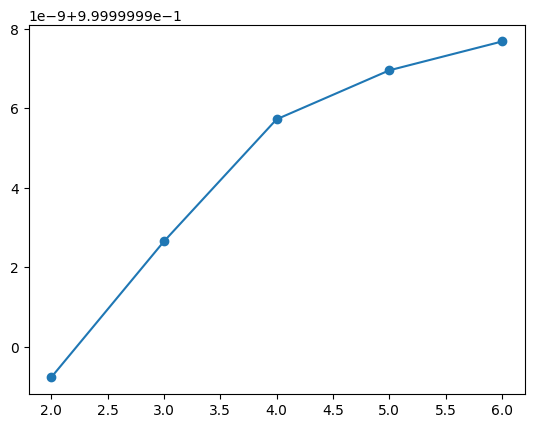

In [113]:
from sklearn.decomposition import PCA
cs = [2, 3, 4, 5, 6]
info = []
for i in cs:
  pca = PCA(n_components=i)
  pca.fit(df_scaler)
  info.append(pca.explained_variance_ratio_.sum())

plt.plot(cs, info, '-o')

In [114]:
pca = PCA(n_components=3)
vis = pca.fit_transform(df_scaler)
# Create a DataFrame for the PCA components

df_vis = pd.DataFrame(vis, columns=['PC1', 'PC2', 'PC3'])

# Plot using Plotly
fig = px.scatter_3d(df_vis, x='PC1', y='PC2', z='PC3', width=600, height=600)
fig.update_traces(marker=dict(size=5))
fig.show()

In [115]:
from sklearn.ensemble import IsolationForest

is_outlier = IsolationForest(contamination=0.15, random_state=0,
                            n_estimators=20).fit_predict(vis)
df_scaler['is_outlier'] = is_outlier
# Convert outlier labels from -1 (outlier) and 1 (inlier) to 'Outlier' and 'Inlier'
df_scaler['is_outlier'] = df_scaler['is_outlier'].map({-1: 1, 1: 0})

fig = px.scatter_3d(df_scaler, x='company_hash', y='ctc', z='job_position', color='is_outlier', width=600, height=600)
fig.update_traces(marker=dict(size=2), selector=dict(mode='markers'))
fig.show()


In [116]:
from sklearn.neighbors import LocalOutlierFactor
is_outlier = LocalOutlierFactor(contamination=0.15, n_neighbors=5).fit_predict(vis)
df_scaler['is_outlier'] = is_outlier
# Convert outlier labels from -1 (outlier) and 1 (inlier) to 'Outlier' and 'Inlier'
df_scaler['is_outlier'] = df_scaler['is_outlier'].map({-1: 1, 1: 0})

fig = px.scatter_3d(df_scaler, x='company_hash', y='ctc', z='job_position', color='is_outlier', width=600, height=600)
fig.update_traces(marker=dict(size=2), selector=dict(mode='markers'))
fig.show()

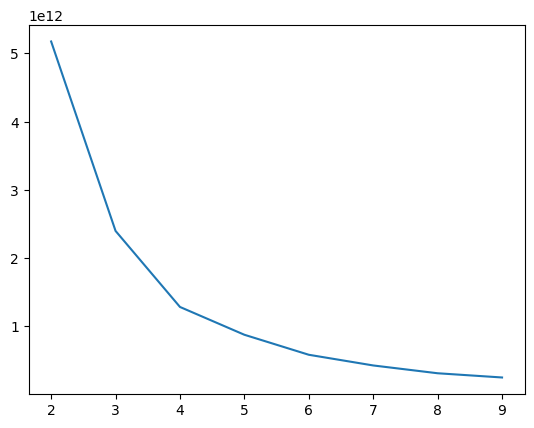

In [117]:
from sklearn.cluster import KMeans

elbow = []
for k in range(2,10):
  kmeans = KMeans(n_clusters=k)
  kmeans.fit(df_scaler)
  elbow.append(kmeans.inertia_)

plt.plot(range(2,10), elbow)

In [118]:
#KMeans Clustering
# Create KMeans instance with KMeans++ initialization
kmeans = KMeans(n_clusters=4, init='k-means++', n_init=10, random_state=42)
kmeans.fit(df_scaler)

# Visualize KMeans clusters
df_scaler['kmeans'] = kmeans.labels_
import plotly.express as px
fig = px.scatter_3d(df_scaler, x='company_hash', y='ctc', z='job_position', color='kmeans', width=600, height=600)
fig.update_traces(marker=dict(size=2), selector=dict(mode='markers'))
fig.show()

In [119]:
# Fit GMM
from sklearn.mixture import GaussianMixture
gmm = GaussianMixture(
                      n_components=4,
                      covariance_type='full',  # Type of covariance parameters: 'full', 'tied', 'diag', 'spherical'
                      tol=1e-3,                # Convergence threshold
                      reg_covar=1e-6,          # Regularization to add to the diagonal of covariance
                      max_iter=100,            # Maximum number of iterations
                      n_init=1,                # Number of initializations to perform
                      init_params='kmeans',    # Initialization method: 'kmeans', 'random'
                      weights_init=None,       # Initial weights
                      means_init=None,         # Initial means
                      precisions_init=None,    # Initial precisions
                      random_state=42,         # Seed for random number generator
                      warm_start=False,        # Reuse the solution of the last call to fit
                      verbose=0,               # Enable verbose output
                      verbose_interval=10
                    )
gmm_labels = gmm.fit_predict(df_scaler)
df_scaler['gmm'] = gmm_labels

# Visualize GMM clusters

import plotly.express as px
fig = px.scatter_3d(df_scaler, x='company_hash', y='ctc', z='job_position', color='gmm', width=600, height=600)
fig.update_traces(marker=dict(size=2), selector=dict(mode='markers'))
fig.show()



In [120]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage

data_for_clustering = df_scaler.sample(n=5000, random_state=42)

# Create AgglomerativeClustering instance
agg_clustering = AgglomerativeClustering(n_clusters=4, affinity='euclidean', linkage='ward')

# Fit the model and predict the clusters
data_for_clustering['hierarchical'] = agg_clustering.fit_predict(data_for_clustering)


# Visualize hierarchical clusters

import plotly.express as px
fig = px.scatter_3d(data_for_clustering, x='company_hash', y='ctc', z='job_position', color='hierarchical', width=600, height=600)
fig.update_traces(marker=dict(size=2), selector=dict(mode='markers'))
fig.show()

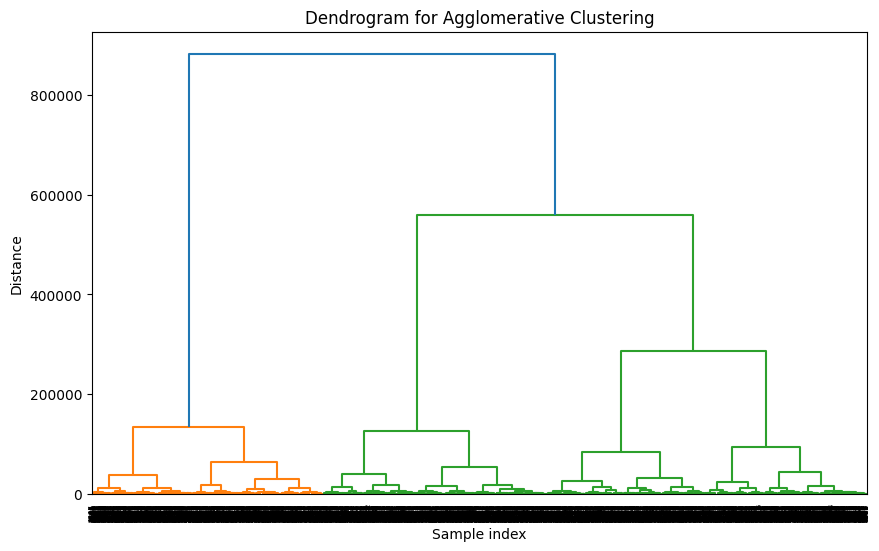

In [121]:
# Compute the linkage matrix
Z = linkage(data_for_clustering, method='ward')

# Plot the dendrogram
plt.figure(figsize=(10, 6))
dendrogram(Z)
plt.title('Dendrogram for Agglomerative Clustering')
plt.xlabel('Sample index')
plt.ylabel('Distance')
plt.show()

# Insights:

1. The distribution of 'ctc' is left-skewed, with a long tail towards higher values. This indicates that there are actually only a few learners with very high salaries.

2. The distribution of ctc_update_year is right-skewed, with a majority of learners having their CTC updated in recent years.

3. The distribution of orgyear shows an increasing trend from 2014 onwards, with most learners enrolled coming from the year 2018.

4. The distribution of job_position is uneven, with a majority of learners in a few positions.

5. The average CTC for the years when ctc was updated, shows a downward trend from 2015 - 2017, and then it goes up until 2020, before it finally declines sharply in 2021.

6. The average ctc of the learners has gone down over the years.


# Recommendations:

Recommendations

1. There are learners from companies that pay very high /high/average/low 'ctc', for both low and high experience levels, so Scaler should have a different sales pitch / strategy for each segment.

2. Most learners come from specific job positions such as backend engineer, front end engineer & full stack. Scaler can work on how to attract people from other job positions.
